# **LAB 1**: Text Processing and Exploratory Data Analysis
Raquel Benjumea: 251235

Clara Jaurés: 254177

Naia Gorostiaga: 253149

# O. Preparation

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
data_path = '/content/drive/Shareddrives/Real ELITE IRWA/Part_1/data'
input_path = '/content/drive/Shareddrives/Real ELITE IRWA/Part_1/input'

In [ ]:
import nltk
nltk.download('stopwords')

from collections import defaultdict
from array import array
import time
from nltk.stem import PorterStemmer
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import math
import numpy as np
import collections
from numpy import linalg as la
import json
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import re

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


# 1. Pre-process the document

In [ ]:
def remove_punctuation(text):
    puntuation = '''!()-[]{};:'"\,<>./?@#$%^&*_~'''

In [ ]:
nltk.download('punkt')
nltk.download('stopwords')

stemmer = PorterStemmer()                       #initialize the Porter Stemmer

stop_words = set(stopwords.words('english'))    #define the stop words in english

punctuation = '''!()-[]{};:'"\,<>./?@#$%^&*_~'''    #define the punctuation we want to remove

def preprocess_text(tweet):
    # Step 1: Remove URLs, hashtags, mentions, and non-alphabetical characters
    tweet = re.sub(r'http\S+|www\S+|https\S+', '', tweet)   # Remove URLs
    tweet = re.sub(r'@\w+', '', tweet)                      # Remove mentions
    tweet = re.sub(r'#\w+', '', tweet)                      # Remove hashtags
    tweet = re.sub(r'[^A-Za-z\s]', '', tweet)               # Remove non-alphabetical character

    # ADDITIONALLY
    tweet = tweet.lower()                                   # As additional pre-processing step
    tweet = re.sub(r'[^\x00-\x7F]+', '', tweet)             # Remove non-ASCII characters(emojis)


    # Step 2: Remove specified punctuation
    tweet = ''.join([char for char in tweet if char not in punctuation])

    # Step 3: Tokenize the tweet text
    words = word_tokenize(tweet)

    # Step 4: Remove stop words
    filtered_words = [word for word in words if word.lower() not in stop_words]

    # Step 5: Apply stemming to each word
    stemmed_words = [stemmer.stem(word) for word in filtered_words]

    # Step 6: Join words back into a cleaned string
    cleaned_tweet = ' '.join(stemmed_words)

    return cleaned_tweet

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
def extract_tweets(text):
    tweet_id = text.get("id","N/A")
    tweet_text = text.get("content","N/A")
    tweet_date = text.get("date", "N/A")
    hashtags = [hashtag[1:] for hashtag in re.findall(r'#\S+', tweet_text)]
    tweet_likes = text.get("likeCount", 0)
    tweet_retweets = text.get("retweetCount", 0)
    url = f"https://twitter.com/{text['user']['username']}/status/{text['id']}"

    #after creating the hashtags we pre-process the content
    tweet_text = preprocess_text(tweet_text)

    return [tweet_id, tweet_text, tweet_date, hashtags, tweet_likes, tweet_retweets, url]


In [ ]:
docs_path = data_path + '/farmers-protest-tweets.json'
clean_tweets = []
with open(docs_path,'r') as fp:
    for line in fp:
        try:
            tweet_data = json.loads(line)
            formatted_tweet = extract_tweets(tweet_data)
            clean_tweets.append(formatted_tweet)
        except json.JSONDecodeError as e:
            print(f"Error decoding JSON: {e}")

In [ ]:
print("Example of the last tweet:\n\tClean tweet: "+clean_tweets[-1][1])

print("\tOriginal tweet: "+tweet_data.get("content","N/A"))

Example of the last tweet:
	Clean tweet: keep morcha aliv strong
	Original tweet: @Kisanektamorcha We are with you, keep the morcha alive and strong 💪 #FarmersProtest #MahapanchayatRevolution


In [ ]:
# Map the tweet ids with the doc Ids
import csv

tweet_document_ids_map = []

# Open the CSV file and read its contents
with open(data_path+'/tweet_document_ids_map.csv', mode='r', newline='') as file:
    reader = csv.reader(file)
    # Iterate through each row and append to the list
    for row in reader:
        tweet_document_ids_map.append(row)

# Now csv_content holds the content of the CSV file
print(tweet_document_ids_map)

doc_tweet_mapping = dict(tweet_document_ids_map)

print(doc_tweet_mapping)

[['docId', 'id'], ['doc_0', '1364506249291784198'], ['doc_1', '1364506237451313155'], ['doc_2', '1364506167226032128'], ['doc_3', '1364505991887347714'], ['doc_4', '1364505813834989568'], ['doc_5', '1364505749359976448'], ['doc_6', '1364505676375076867'], ['doc_7', '1364505511073300481'], ['doc_8', '1364505452134817795'], ['doc_9', '1364505443997937669'], ['doc_10', '1364505314586951680'], ['doc_11', '1364505255946379268'], ['doc_12', '1364505170743238659'], ['doc_13', '1364505014530531330'], ['doc_14', '1364504850524995587'], ['doc_15', '1364504705460658179'], ['doc_16', '1364504358277308416'], ['doc_17', '1364504281618001921'], ['doc_18', '1364504256934408193'], ['doc_19', '1364503870651555840'], ['doc_20', '1364503539322671108'], ['doc_21', '1364503376885473282'], ['doc_22', '1364503314407124992'], ['doc_23', '1364503215232798721'], ['doc_24', '1364502921858211840'], ['doc_25', '1364502574280409091'], ['doc_26', '1364502520412930049'], ['doc_27', '1364502280167325699'], ['doc_28', '

In [ ]:
def create_index(lines):
    """
    Implement the inverted index

    Argument:
    lines -- collection of tweets: tweet_id, tweet_text, tweet_date, hashtags, tweet_likes, tweet_retweets, url

    Returns:
    index - the inverted index (implemented through a Python dictionary) containing terms as keys and the corresponding
    list of tweets where these keys appears in (and the positions) as values.
    """
    index = defaultdict(list)
    title_index = {}    # dictionary to map words to tweet ids
    for line in lines:  # Remember, lines contain all tweets: tweet_id, tweet_text, tweet_date, hashtags, tweet_likes, tweet_retweets, url

        tweet_id = int(line[0])
        tweet_text = line[1]

        ## ===============================================================
        ## create the index for the current page and store it in current_page_index (current_page_index)
        ## current_page_index ==> { ‘term1’: [tweet_id, [list of positions]], ...,‘term_n’: [tweet_id, [list of positions]]}

        ## Example: if the tweet_id has id 1 and his text is
        ##"web retrieval information retrieval":

        ## current_page_index ==> { ‘web’: [1, [0]], ‘retrieval’: [1, [1,4]], ‘information’: [1, [2]]}

        ## the term ‘web’ appears in document 1 in positions 0,
        ## the term ‘retrieval’ appears in document 1 in positions 1 and 4
        ## ===============================================================

        current_page_index = {}

        for position, term in enumerate(tweet_text.split()):       # terms contains page_title + page_text. Loop over all terms
            if term in current_page_index:
                # if the term is already in the index for the current page (current_page_index)
                # append the position to the corresponding list
                current_page_index[term][1].append(position)

            else:
                # Add the new term as dict key and initialize the array of positions and add the position
                current_page_index[term]=[tweet_id, array('I',[position])]     #'I' indicates unsigned int (int in Python)

        #merge the current page index with the main index
        for term_page, posting_page in current_page_index.items():
            index[term_page].append(posting_page)

        ## END CODE

    return index

In [ ]:
index = create_index(clean_tweets)

In [ ]:
print(index)

defaultdict(<class 'list'>, {'world': [[1364506249291784198, array('I', [0])], [1364499669271855104, array('I', [10])], [1364497821953495052, array('I', [7])], [1364492327952220160, array('I', [0])], [1364492295626752000, array('I', [6])], [1364486575757791234, array('I', [8])], [1364482218228334596, array('I', [0])], [1364474962380091395, array('I', [3])], [1364467630011150339, array('I', [12])], [1364467283423338496, array('I', [2])], [1364460346220695555, array('I', [8])], [1364450375680610304, array('I', [3])], [1364446733711761411, array('I', [7])], [1364445818757939201, array('I', [22])], [1364431486036963330, array('I', [4])], [1364429165517135875, array('I', [9])], [1364418904496373764, array('I', [0])], [1364417923226419200, array('I', [4])], [1364413927325655041, array('I', [12])], [1364407896893661186, array('I', [4])], [1364407713329868805, array('I', [4])], [1364406945084370944, array('I', [7])], [1364401769657167879, array('I', [7])], [1364395918791950336, array('I', [4])

# 2. Exploratory Data Analysis

## 2.1. Word counting distribution

First we will count the number of occurrences overall.

Total counts of each word:
world :  2001
progress :  67
indian :  2982
polic :  1738
govt :  2396


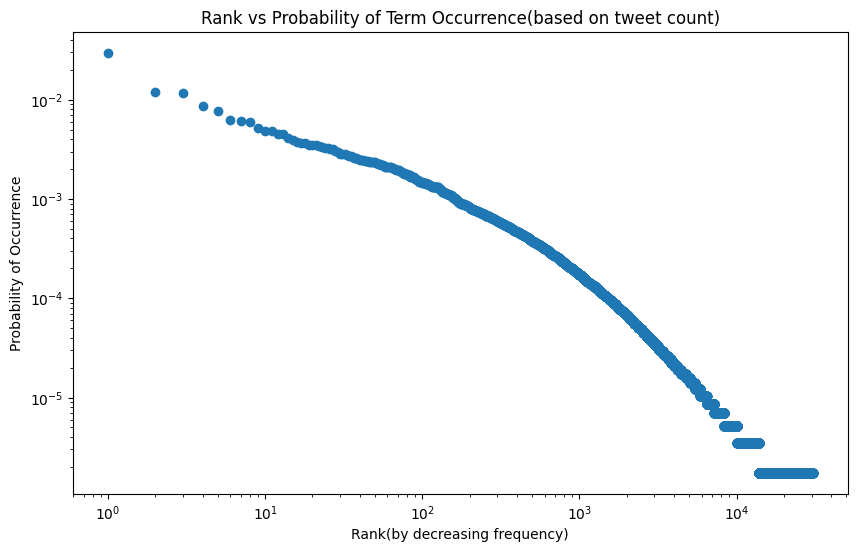

In [ ]:
# 1. Calculate frequencies of terms: we need to take into account that one tweet might contain the same term more than once!!
term_frequencies = {}
for term, tweet_data in index.items():          #(word, tweet_ids with corresponding positions)
    total_occurrences = 0
    for tweet_id, positions in tweet_data:
        total_occurrences += len(positions)     #count occurrences of the term in the tweet
    term_frequencies[term] = total_occurrences  #sum of occurrences across all tweets

# Print the first 5 elements
print('Total counts of each word:')
for i, (key, value) in enumerate(term_frequencies.items()):
    if i < 5:
        print(key, ': ', value)

# 2. Rank terms by decreasing frequency
sorted_terms = sorted(term_frequencies.items(), key=lambda x: x[1], reverse=True)
ranks = np.arange(1, len(sorted_terms) + 1)   #rank based on order (1 for highest frequency, 2 for second highest, etc.)

# 3. Total number of occurrences(sum of all frequencies)
total_occurrences = sum(freq for term, freq in sorted_terms)

# 4. Calculate probabilities for each term
probabilities = [freq / total_occurrences for term, freq in sorted_terms]

# 6. Plotting rank vs probability in log-log scale
plt.figure(figsize=(10, 6))
plt.loglog(ranks, probabilities, marker="o", linestyle="none")
plt.xlabel('Rank(by decreasing frequency)')
plt.ylabel('Probability of Occurrence')
plt.title('Rank vs Probability of Term Occurrence(based on tweet count)')
plt.show()

This plot that we get of rank vs probability of term occurrence, makes sense taking into account the Zip's Law. This is the curve we obtain in logaritmical scale.

## 2.2. Average sentence lenth

In [ ]:
from nltk.tokenize import sent_tokenize, word_tokenize

total_words = 0
total_sentences= 0
clean_tweets = []

i = 0

with open(docs_path,'r') as fp:
    for line in fp:
        try:
            tweet_data = json.loads(line)
            tweet = tweet_data.get("content","N/A")

            ## PRE-PROCESSING
            # Remove URLs, hashtags, mentions, and non-alphabetical characters
            tweet = re.sub(r'http\S+|www\S+|https\S+', '', tweet)   # Remove URLs
            tweet = re.sub(r'@\w+', '', tweet)                      # Remove mentions
            tweet = re.sub(r'#\w+', '', tweet)                      # Remove hashtags

            # ADDITIONALLY
            tweet = tweet.lower()                                   # As additional pre-processing step
            tweet = re.sub(r'[^\x00-\x7F]+', '', tweet)             # Remove non-ASCII characters(emojis)

            # Tokenize the tweet text in sentences, we remove punctiation after this step
            sentences = sent_tokenize(tweet)

            # Print the first 5 tweets' sentences to see wether it is operating correctly
            if (i < 5):
              print("\n", i, ".Sentences before processing:")
              print(sentences)

            formatted_sentences = []
            for sentence in sentences:
                words = word_tokenize(sentence)
                # Remove punctuation from the word list(after tokenizing it)
                words = [word for word in words if word not in punctuation]

                # Remove stop words
                filtered_words = [word for word in words if word.lower() not in stop_words]

                # Apply stemming to each word
                stemmed_words = [stemmer.stem(word) for word in filtered_words]

                total_words += len(stemmed_words)

                formatted_sentences.append(' '.join(stemmed_words))

            # clean_sentences = ' '.joint(formatted_sentences)
            if (i < 5):
              print(i, '.Formatted_sentences:')
              print(formatted_sentences)

            #Calculate total number of sentences
            total_sentences += len(sentences)
            i += 1

            # clean_tweets_sentences.append(formatted_tweet)
        except json.JSONDecodeError as e:
            print(f"Error decoding JSON: {e}")

#Compute average sentence length
if total_sentences > 0:
    average_sentence_length = total_words / total_sentences
    print(f"\nOverall average sentence length: {average_sentence_length:.2f} words per sentence")
else:
    print("No sentences found.")


 0 .Sentences before processing
['the world progresses while the indian police and govt are still trying to take india back to the horrific past through its tyranny.', 'shame on you.']
0 .Formatted_sentences:
['world progress indian polic govt still tri take india back horrif past tyranni', 'shame']

 1 .Sentences before processing
[' \n \n \n \nfarmers constantly distroying crops throughout india.', "really, it's hearts breaking...we care about our crops like our children.", 'and govt.', 'agriculture minister is laughing on uswe will win']
1 .Formatted_sentences:
['farmer constantli distroy crop throughout india', "realli 's heart break ... care crop like children", 'govt', 'agricultur minist laugh usw win']

 2 .Sentences before processing
["       \n   ()      '"]
2 .Formatted_sentences:
['']

 3 .Sentences before processing
['  watch full video here']
3 .Formatted_sentences:
['watch full video']

 4 .Sentences before processing
[]
4 .Formatted_sentences:
[]


## 2.3. Vocabulary size

We want to see the relation between the number of words seen so far(from the entire collection, corpus) against the number of unique words(vocabulary) encountered as we process more and more tweets.

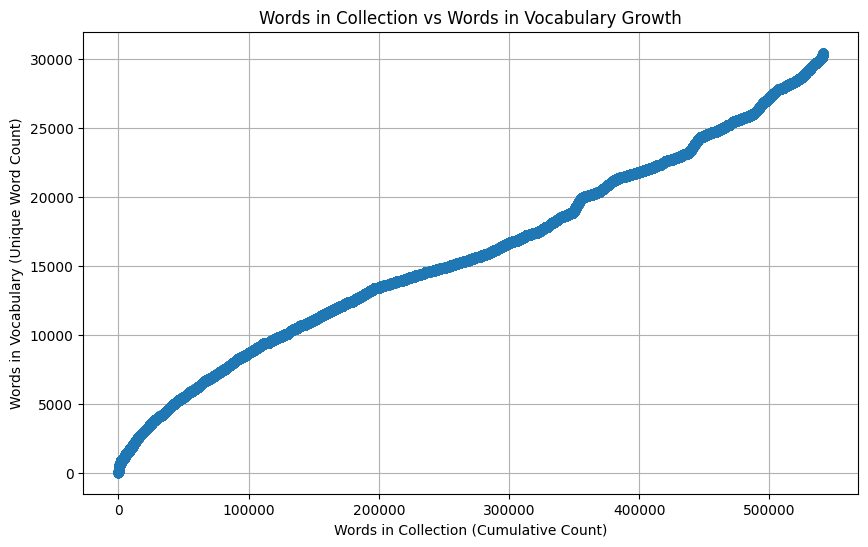

In [ ]:
#vocabulary size
import matplotlib.pyplot as plt
from collections import defaultdict, Counter
from itertools import chain

# 1. Flatten the tweet_ids to simulate word occurrences in collection
tweet_words = defaultdict(list)
for word, tweet_data in index.items():
    for tweet_id, _ in tweet_data:
        tweet_words[tweet_id].append(word)  # Group words by tweet_id

# 2. Create a list to track word occurrences(flattened view of the collection)
all_words_in_collection = list(chain(*tweet_words.values()))  # All word occurrences

# 3. Track the vocabulary growth(unique words encountered)
vocabulary = set()      #unique words
cumulative_words = []   #cumulative number of words in the collection
vocabulary_size = []    # #unique words

for word in all_words_in_collection:
    vocabulary.add(word)                                #add word
    cumulative_words.append(len(cumulative_words) + 1)  #total words seen so far
    vocabulary_size.append(len(vocabulary))             #unique words seen so far

# 4. Plot cumulative word count vs vocabulary size
plt.figure(figsize=(10, 6))
plt.plot(cumulative_words, vocabulary_size, marker="o")
plt.xlabel('Words in Collection (Cumulative Count)')
plt.ylabel('Words in Vocabulary (Unique Word Count)')
plt.title('Words in Collection vs Words in Vocabulary Growth')
plt.grid(True)
plt.show()

## 2.4. Ranking of tweets most retweeted

In [ ]:
# Sort the tweets by the number of retweets (index 5 is the retweet count)
sorted_tweets = sorted(clean_tweets, key=lambda x: x[5], reverse=True)

# We will display the top 20
top_20_tweets =[]
top_20_tweets = sorted_tweets[:20]  # Slicing to get the top 20

for rank, tweet in enumerate(top_20_tweets, start=1):
    tweet_id, tweet_text, tweet_date, hashtags, tweet_likes, tweet_retweets, url = tweet
    print(f"Rank {rank}: Tweet ID: {tweet_id}, Retweets: {tweet_retweets}, text: {tweet_text}")

We need to take into account that the text of the tweets is pre-processed, and that is why some seem to be void. If we observe the tweets before pre-processing(by the ID), we can observe that the most retweeted tweet has been: "#FarmLaws #FarmersProtest #". As its content is just hashtags, these have been remvoved in teh pre-processing process.

In [ ]:
# Filter out tweets with empty text
ranking_non_empty_tweets = [tweet for tweet in sorted_tweets if tweet[1] != '']      #tweet[1] is tweet_text

# We will display the top 20
top_20_tweets_non_empty = []
top_20_tweets_non_empty = ranking_non_empty_tweets[:20]  # Slicing to get the top 20

for rank, tweet in enumerate(top_20_tweets_non_empty, start=1):
    tweet_id, tweet_text, tweet_date, hashtags, tweet_likes, tweet_retweets, url = tweet
    print(f"Rank {rank}: Tweet ID: {tweet_id}, Retweets: {tweet_retweets}, Text: {tweet_text}")